In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from collections import defaultdict


In [2]:
from sklearn.model_selection import train_test_split, cross_val_score 

from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc, roc_auc_score

In [3]:
df = pd.read_csv("/Users/matteoppa/Desktop/fma_metadata/df_to_work1.csv")

In [4]:
column2drop= ["Unnamed: 0"]

In [5]:
df.drop(column2drop, inplace=True, axis=1)

In [6]:
df['liked_bin'] = np.nan
for i in range(0,len(df)):
    if df['liked'][i] == 0 or df['liked'][i] == 1:
        df['liked_bin'][i] = 0  #34 
    else:
        df['liked_bin'][i] = 1 #012

<ipython-input-6-25649067ecc7>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['liked_bin'][i] = 0  #34
<ipython-input-6-25649067ecc7>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['liked_bin'][i] = 1 #012


In [9]:
class_name = 'liked_bin'

In [7]:
column2drop1= ["liked"]
df.drop(column2drop1, inplace=True, axis=1)

In [10]:
attributes = [col for col in df.columns if col != class_name]
X = df[attributes].values
y = df[class_name]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3,random_state=100, stratify=y)

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [12]:
test= pd.read_csv("/Users/matteoppa/Desktop/fma_metadata/test_fma.csv")

# Normalization

In [10]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [11]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)
X_val = scaler.transform(X_val)

In [16]:
from sklearn.datasets import make_classification
from imblearn.over_sampling import RandomOverSampler

In [17]:
ros = RandomOverSampler(random_state=0)

In [18]:
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train)

# PCA

In [13]:
from sklearn.decomposition import PCA

In [14]:
pca = PCA(n_components=2)
pca.fit(X_train)
X_pca = pca.transform(X_train)

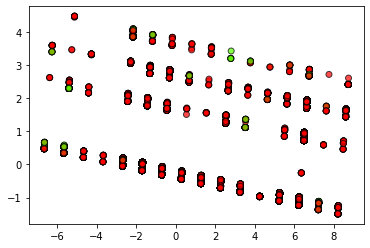

In [15]:
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train, cmap=plt.cm.prism, edgecolor='k', alpha=0.7)
plt.show()

# LINEAR SVM

In [17]:
from sklearn.svm import LinearSVC

In [22]:
clf = LinearSVC(C=0.001,dual=False)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.8391254897004928
F1-score [0.91252663 0.        ]
              precision    recall  f1-score   support

         0.0       0.84      1.00      0.91     13280
         1.0       0.00      0.00      0.00      2546

    accuracy                           0.84     15826
   macro avg       0.42      0.50      0.46     15826
weighted avg       0.70      0.84      0.77     15826

/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [23]:
clf = LinearSVC(loss='hinge', C=1.0)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.8391254897004928
F1-score [0.91252663 0.        ]
              precision    recall  f1-score   support

         0.0       0.84      1.00      0.91     13280
         1.0       0.00      0.00      0.00      2546

    accuracy                           0.84     15826
   macro avg       0.42      0.50      0.46     15826
weighted avg       0.70      0.84      0.77     15826

/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [24]:
clf = LinearSVC(loss='hinge', C=100.0)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.8276254265133325
F1-score [0.90563166 0.0058309 ]
              precision    recall  f1-score   support

         0.0       0.84      0.99      0.91     13280
         1.0       0.04      0.00      0.01      2546

    accuracy                           0.83     15826
   macro avg       0.44      0.49      0.46     15826
weighted avg       0.71      0.83      0.76     15826

/opt/anaconda3/lib/python3.8/site-packages/sklearn/svm/_base.py:976: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "


In [25]:
clf = LinearSVC(loss='hinge', C=0.01,class_weight='balanced')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.6104511563250348
F1-score [0.72042084 0.35787939]
              precision    recall  f1-score   support

         0.0       0.91      0.60      0.72     13280
         1.0       0.24      0.67      0.36      2546

    accuracy                           0.61     15826
   macro avg       0.57      0.64      0.54     15826
weighted avg       0.80      0.61      0.66     15826



In [26]:
clf = LinearSVC(loss='hinge', C=1)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.8391254897004928
F1-score [0.91252663 0.        ]
              precision    recall  f1-score   support

         0.0       0.84      1.00      0.91     13280
         1.0       0.00      0.00      0.00      2546

    accuracy                           0.84     15826
   macro avg       0.42      0.50      0.46     15826
weighted avg       0.70      0.84      0.77     15826

/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [30]:
clf = LinearSVC(loss='hinge',C=100, class_weight="balanced")
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.8132819411095665
F1-score [0.89559411 0.11764706]
              precision    recall  f1-score   support

         0.0       0.84      0.95      0.90     13280
         1.0       0.25      0.08      0.12      2546

    accuracy                           0.81     15826
   macro avg       0.54      0.52      0.51     15826
weighted avg       0.75      0.81      0.77     15826

/opt/anaconda3/lib/python3.8/site-packages/sklearn/svm/_base.py:976: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "


In [20]:
decision_function = clf.decision_function(X_train)
support_vector_indices = np.where((2 * y_train - 1) * decision_function <= 1)[0]
support_vectors = X_train[support_vector_indices]

In [21]:
support_vectors_pca = pca.transform(support_vectors)

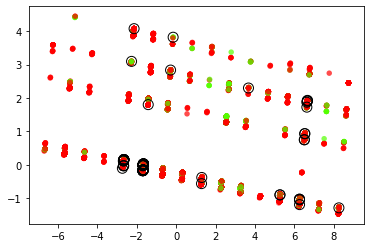

In [22]:
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train, cmap=plt.cm.prism, edgecolor='none', alpha=0.7, s=30)
plt.scatter(support_vectors_pca[:100, 0], support_vectors_pca[:100, 1], s=100,
                linewidth=1, facecolors='none', edgecolors='k')
plt.show()

# C 

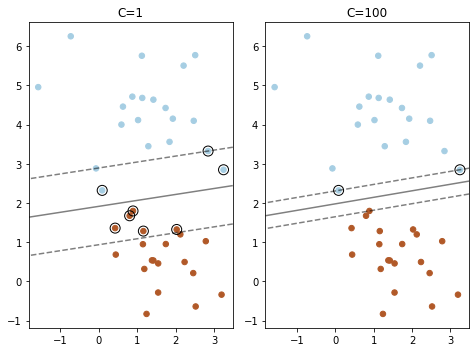

In [23]:
from sklearn.datasets import make_blobs
from sklearn.svm import LinearSVC

X, y = make_blobs(n_samples=40, centers=2, random_state=0)

plt.figure(figsize=(10, 5))
for i, C in enumerate([1, 100]):
    # "hinge" is the standard SVM loss
    clf = LinearSVC(C=C, loss="hinge", random_state=42).fit(X, y)
    # obtain the support vectors through the decision function
    decision_function = clf.decision_function(X)
    # we can also calculate the decision function manually
    # decision_function = np.dot(X, clf.coef_[0]) + clf.intercept_[0]
    support_vector_indices = np.where((2 * y - 1) * decision_function <= 1)[0]
    support_vectors = X[support_vector_indices]

    plt.subplot(1, 3, i + 1)
    plt.scatter(X[:, 0], X[:, 1], c=y, s=30, cmap=plt.cm.Paired)
    ax = plt.gca()
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 50),
                         np.linspace(ylim[0], ylim[1], 50))
    Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    plt.contour(xx, yy, Z, colors='k', levels=[-1, 0, 1], alpha=0.5,
                linestyles=['--', '-', '--'])
    plt.scatter(support_vectors[:, 0], support_vectors[:, 1], s=100,
                linewidth=1, facecolors='none', edgecolors='k')
    plt.title("C=" + str(C))
plt.tight_layout()
plt.show()

# NON LINEAR SVM

In [18]:
from sklearn.svm import SVC

In [13]:
clf = SVC(gamma='auto', C=0.01, class_weight='balanced')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.5907367622899027
F1-score [0.6957012  0.37522909]
              precision    recall  f1-score   support

         0.0       0.93      0.56      0.70     13307
         1.0       0.25      0.77      0.38      2519

    accuracy                           0.59     15826
   macro avg       0.59      0.66      0.54     15826
weighted avg       0.82      0.59      0.64     15826



In [14]:
clf = SVC(gamma='auto', C=1, class_weight='balanced')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.6516491848856313
F1-score [0.74825334 0.43473803]
              precision    recall  f1-score   support

         0.0       0.95      0.62      0.75     13307
         1.0       0.29      0.84      0.43      2519

    accuracy                           0.65     15826
   macro avg       0.62      0.73      0.59     15826
weighted avg       0.85      0.65      0.70     15826



In [15]:
clf = SVC(gamma='auto', C=100, class_weight='balanced')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.7397952736004044
F1-score [0.82394186 0.50157347]
              precision    recall  f1-score   support

         0.0       0.96      0.72      0.82     13307
         1.0       0.36      0.82      0.50      2519

    accuracy                           0.74     15826
   macro avg       0.66      0.77      0.66     15826
weighted avg       0.86      0.74      0.77     15826



In [18]:
clf1 = SVC(gamma='scale', C=100, class_weight='balanced')
clf1.fit(X_train, y_train)

y_pred = clf1.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.7397952736004044
F1-score [0.82394186 0.50157347]
              precision    recall  f1-score   support

         0.0       0.96      0.72      0.82     13307
         1.0       0.36      0.82      0.50      2519

    accuracy                           0.74     15826
   macro avg       0.66      0.77      0.66     15826
weighted avg       0.86      0.74      0.77     15826



In [16]:
clf = SVC(gamma='auto', C=100, kernel='sigmoid', class_weight='balanced')
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print('Accuracy %s' % accuracy_score(y_test, y_pred))
print('F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))

Accuracy 0.5382914191836219
F1-score [0.66507769 0.25704118]
              precision    recall  f1-score   support

         0.0       0.85      0.55      0.67     13307
         1.0       0.17      0.50      0.26      2519

    accuracy                           0.54     15826
   macro avg       0.51      0.52      0.46     15826
weighted avg       0.74      0.54      0.60     15826



In [ ]:
clf.support_

In [ ]:
clf.support_vectors_[:10]

In [ ]:
clf.n_support_, len(X_train)

# REPRESENTING DIFFERENT KERNELS

In [21]:



# fit the model
for kernel in ('linear', 'rbf', 'poly', 'sigmoid'):
    clf = SVC(kernel=kernel, gamma=10)
    clf.fit(X_train, y_train)

    plt.figure()
    plt.clf()
    plt.scatter(X[:, 0], X[:, 1], c=y, zorder=10, cmap=plt.cm.Paired,
                edgecolor='k', s=20)

    # Circle out the test data
    plt.scatter(X_test[:, 0], X_test[:, 1], s=80, facecolors='none',
                zorder=10, edgecolor='k')

    plt.axis('tight')
    x_min = X[:, 0].min()
    x_max = X[:, 0].max()
    y_min = X[:, 15].min()
    y_max = X[:, 15].max()

    XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
    Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(XX.shape)
    plt.pcolormesh(XX, YY, Z > 0, cmap=plt.cm.Paired)
    plt.contour(XX, YY, Z, colors=['k', 'k', 'k'],
                linestyles=['--', '-', '--'], levels=[-.5, 0, .5])

    plt.title(kernel)
plt.show()

ValueError: X.shape[1] = 2 should be equal to 16, the number of features at training time